In [1]:
!pip3 install mysql-connector-python

In [2]:
import mysql.connector
import pandas as pd
pd.set_option('display.max_columns', None)                      # Unfolding hidden features if the cardinality is high
pd.set_option('display.max_colwidth', None)                     # Unfolding the max feature width for better clarity
pd.set_option('display.max_rows', None)                         # Unfolding hidden features if the cardinality is high
pd.set_option('mode.chained_assignment', None)                  # Removing restriction over chained assignment operations
pd.set_option('display.float_format', lambda x: '%.5f' % x)     # To suppress scientific notation over exponential values
import numpy as np
from pandas_profiling import ProfileReport
import folium
from folium.plugins import MarkerCluster
import matplotlib.pyplot as plt  
import seaborn as sns            
%matplotlib inline
sns.set()

C:\Users\10011487\AppData\Local\Temp\ipykernel_2928\1599389369.py:9: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


In [3]:
# connection details
cnx = mysql.connector.connect(
   host="cpanel.insaid.co",
   user="student",
   passwd="student",
   database='Capstone1'
)

In [4]:
# open cursor
cursor = cnx.cursor()
# query
query = "SELECT TABLE_NAME FROM INFORMATION_SCHEMA.TABLES WHERE table_schema ='Capstone1'"
# execute query
cursor.execute(query)
# fetch results
result = cursor.fetchall()
# print results
for table in result:
    print (table)

# close connection
#cnx.close()

('events_data',)
('gender_age_train',)
('phone_brand_device_model',)


In [5]:
cursor = cnx.cursor()

In [6]:
query_gender_age_train = ("SELECT * FROM gender_age_train")
query_phone_brand_device_model = ("SELECT * FROM phone_brand_device_model")
#query_events_data = ("select * from events_data where state in ('TamilNadu', 'Manipur', 'Chandigarh', 'Tripura', 'UttarPradesh', 'ArunachalPradesh')")

In [7]:
cursor.execute(query_gender_age_train)
table_rows = cursor.fetchall()
df_gender_age_train = pd.DataFrame(table_rows,columns = ['device_id','gender','age','group'])
df_gender_age_train.head()

,device_id,gender,age,group
0,-8076087639492063270,M,35,M32-38
1,-2897161552818060146,M,35,M32-38
2,-8260683887967679142,M,35,M32-38
3,-4938849341048082022,M,30,M29-31
4,245133531816851882,M,30,M29-31


In [8]:
cursor.execute(query_phone_brand_device_model)
table_rows = cursor.fetchall()
df_phone_brand_device_model = pd.DataFrame(table_rows, columns=['device_id', 'phone_brand', 'device_model'])
df_phone_brand_device_model.head()

,device_id,phone_brand,device_model
0,1877775838486905855,vivo,Y13
1,-3766087376657242966,小米,V183
2,-6238937574958215831,OPPO,R7s
3,8973197758510677470,三星,A368t
4,-2015528097870762664,小米,红米Note2


In [9]:
df_events_data = pd.read_csv("20230503_events_data.csv")
df_events_data.head()

,event_id,device_id,timestamp,longitude,latitude,city,state
0,2765368,2973347786994914304.00000,2016-05-07 22:52:05,77.22568,28.73014,Delhi,Delhi
1,2955066,4734221357723754496.00000,2016-05-01 20:44:16,88.38836,22.66033,Calcutta,WestBengal
2,605968,-3264499652692492800.00000,2016-05-02 14:23:04,77.25681,28.75791,Delhi,Delhi
3,448114,5731369272434022400.00000,2016-05-03 13:21:16,80.34361,13.15333,Chennai,TamilNadu
4,665740,338888002570799936.00000,2016-05-06 03:51:05,85.99774,23.84261,Bokaro,Jharkhand


In [10]:
df_events_data.shape

(3252950, 7)

In [11]:
df_events_data.info(show_counts = True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3252950 entries, 0 to 3252949
Data columns (total 7 columns):
 #   Column     Non-Null Count    Dtype  
---  ------     --------------    -----  
 0   event_id   3252950 non-null  int64  
 1   device_id  3252497 non-null  float64
 2   timestamp  3252950 non-null  object 
 3   longitude  3252527 non-null  float64
 4   latitude   3252527 non-null  float64
 5   city       3252950 non-null  object 
 6   state      3252573 non-null  object 
dtypes: float64(3), int64(1), object(3)
memory usage: 173.7+ MB


In [12]:
df_events_data.isna().sum()

event_id       0
device_id    453
timestamp      0
longitude    423
latitude     423
city           0
state        377
dtype: int64

In [13]:
100*df_events_data.isna().sum()/df_events_data['event_id'].count()

event_id    0.00000
device_id   0.01393
timestamp   0.00000
longitude   0.01300
latitude    0.01300
city        0.00000
state       0.01159
dtype: float64

In [14]:
df_phone_brand_device_model.shape

(87726, 3)

In [15]:
df_phone_brand_device_model.info(show_counts = True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87726 entries, 0 to 87725
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   device_id     87726 non-null  int64 
 1   phone_brand   87726 non-null  object
 2   device_model  87726 non-null  object
dtypes: int64(1), object(2)
memory usage: 2.0+ MB


In [16]:
df_phone_brand_device_model.isna().sum()

device_id       0
phone_brand     0
device_model    0
dtype: int64

In [17]:
df_gender_age_train.shape

(74645, 4)

In [18]:
df_gender_age_train.info(show_counts = True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74645 entries, 0 to 74644
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   device_id  74645 non-null  int64 
 1   gender     74645 non-null  object
 2   age        74645 non-null  int64 
 3   group      74645 non-null  object
dtypes: int64(2), object(2)
memory usage: 2.3+ MB


In [19]:
df_gender_age_train.isna().sum()

device_id    0
gender       0
age          0
group        0
dtype: int64

In [20]:
null_data_device_id = df_events_data[df_events_data['device_id'].isnull()]
null_data_longitude = df_events_data[df_events_data['longitude'].isnull()]
null_data_state = df_events_data[df_events_data['state'].isnull()]

In [21]:
null_data_device_id.isna().sum()

event_id       0
device_id    453
timestamp      0
longitude      0
latitude       0
city           0
state          0
dtype: int64

In [22]:
null_data_longitude.isna().sum()

event_id       0
device_id      0
timestamp      0
longitude    423
latitude     423
city           0
state          0
dtype: int64

In [23]:
null_data_state.isna().sum()

event_id       0
device_id      0
timestamp      0
longitude      0
latitude       0
city           0
state        377
dtype: int64

In [24]:
df_state_city = df_events_data[['state', 'city']].drop_duplicates(subset = 'city')

In [25]:
state_city_dic = pd.Series(df_state_city.state.values,index=df_state_city.city).to_dict()
state_city_dic

# Other methods
# dict(zip(df_state_city.state,df_state_city.city))

{'Delhi': 'Delhi',
 'Calcutta': 'WestBengal',
 'Chennai': 'TamilNadu',
 'Bokaro': 'Jharkhand',
 'Visakhapatnam': 'AndhraPradesh',
 'Wanparti': 'AndhraPradesh',
 'Mumbai': 'Maharashtra',
 'Pune': 'Maharashtra',
 'Gandhidham': 'Gujarat',
 'Thalassery': 'Kerala',
 'Pusad': 'Maharashtra',
 'Anjangaon': 'Maharashtra',
 'Indore': 'MadhyaPradesh',
 'Paramakkudi': 'TamilNadu',
 'ChikBallapur': 'Karnataka',
 'Gopichettipalaiyam': 'TamilNadu',
 'Nashik': 'Maharashtra',
 'Basmat': 'Maharashtra',
 'Jaipur': 'Rajasthan',
 'Virappanchatram': 'TamilNadu',
 'Sunabeda': 'Orissa',
 'Fazilka': 'Punjab',
 'Aonla': 'UttarPradesh',
 'Adoni': 'AndhraPradesh',
 'Kohima': 'Nagaland',
 'Moga': 'Punjab',
 'Jagadhri': 'Haryana',
 'Kuniyamuthur': 'TamilNadu',
 'Virudhachalam': 'TamilNadu',
 'Thuthukkudi': 'TamilNadu',
 'Sendhwa': 'MadhyaPradesh',
 'Bangalore': 'Karnataka',
 'Hyderabad': 'Telangana',
 'Bodhan': 'AndhraPradesh',
 'Tilhar': 'UttarPradesh',
 'Maheshtala': 'WestBengal',
 'Akola': 'Maharashtra',
 'Bally

In [26]:
df_events_data['state'] = df_events_data['state'].fillna(df_events_data['city'].apply(lambda x : state_city_dic.get(x)))
df_events_data.isna().sum()

event_id       0
device_id    453
timestamp      0
longitude    423
latitude     423
city           0
state          0
dtype: int64

In [27]:
state_options = ['TamilNadu', 'Manipur', 'Chandigarh', 'Tripura', 'UttarPradesh', 'ArunachalPradesh']

In [28]:
df_events_data.shape

(3252950, 7)

In [29]:
df_ed_6states = df_events_data[df_events_data.state.isin(state_options)]

In [30]:
df_ed_6states.shape

(534462, 7)

In [31]:
df_ed_6states.isna().sum()

event_id      0
device_id    63
timestamp     0
longitude    63
latitude     63
city          0
state         0
dtype: int64

In [32]:
df_ed_6states_new = df_ed_6states.dropna()

In [33]:
df_ed_6states_new.shape

(534336, 7)

In [34]:
df_ed_6states_new.isna().sum()

event_id     0
device_id    0
timestamp    0
longitude    0
latitude     0
city         0
state        0
dtype: int64

In [35]:
df_ed_6states.shape

(534462, 7)

In [36]:
df_ed_6states.isna().sum()

event_id      0
device_id    63
timestamp     0
longitude    63
latitude     63
city          0
state         0
dtype: int64

In [37]:
df_ed_6states['LatLong'] = df_ed_6states['latitude'].map(str) + df_ed_6states['longitude'].map(str)

In [38]:
df_ed_6states.head()

,event_id,device_id,timestamp,longitude,latitude,city,state,LatLong
3,448114,5731369272434022400.00000,2016-05-03 13:21:16,80.34361,13.15333,Chennai,TamilNadu,13.15333280.34361299999998
6,2948755,5536513450525271040.00000,2016-05-03 16:20:14,80.35980,13.12817,Chennai,TamilNadu,13.12817480.359796
10,3219828,-3433061233631405568.00000,2016-05-03 00:27:21,80.29078,13.11543,Chennai,TamilNadu,13.11542780.290779
14,460645,7983871429718484992.00000,2016-05-04 21:04:40,80.33543,13.18905,Chennai,TamilNadu,13.18905380.33543499999998
15,998037,7594215820567964672.00000,2016-05-03 20:59:09,80.30687,13.17297,Chennai,TamilNadu,13.1729780.306871


In [39]:
df_ed_6states_new['LatLong'] = df_ed_6states_new['latitude'].map(str) + df_ed_6states_new['longitude'].map(str)

In [40]:
df_ed_6states_new.head()

,event_id,device_id,timestamp,longitude,latitude,city,state,LatLong
3,448114,5731369272434022400.00000,2016-05-03 13:21:16,80.34361,13.15333,Chennai,TamilNadu,13.15333280.34361299999998
6,2948755,5536513450525271040.00000,2016-05-03 16:20:14,80.35980,13.12817,Chennai,TamilNadu,13.12817480.359796
10,3219828,-3433061233631405568.00000,2016-05-03 00:27:21,80.29078,13.11543,Chennai,TamilNadu,13.11542780.290779
14,460645,7983871429718484992.00000,2016-05-04 21:04:40,80.33543,13.18905,Chennai,TamilNadu,13.18905380.33543499999998
15,998037,7594215820567964672.00000,2016-05-03 20:59:09,80.30687,13.17297,Chennai,TamilNadu,13.1729780.306871


In [41]:
df_ed_6states_new.isna().sum()

event_id     0
device_id    0
timestamp    0
longitude    0
latitude     0
city         0
state        0
LatLong      0
dtype: int64

In [42]:
df_ed_6states.isna().sum()

event_id      0
device_id    63
timestamp     0
longitude    63
latitude     63
city          0
state         0
LatLong       0
dtype: int64

In [43]:
df_latlong_did = df_ed_6states_new[['LatLong', 'device_id', 'longitude', 'latitude']].drop_duplicates(subset = 'LatLong')
latlong_did_dic = pd.Series(df_latlong_did.device_id.values, index=df_latlong_did.LatLong).to_dict()
df_ed_6states['device_id'] = df_ed_6states['device_id'].fillna(df_ed_6states['LatLong'].apply(lambda x : latlong_did_dic.get(x)))
df_ed_6states.isna().sum()

event_id      0
device_id     0
timestamp     0
longitude    63
latitude     63
city          0
state         0
LatLong       0
dtype: int64

In [44]:
df_latlong_did = df_ed_6states_new[['LatLong', 'device_id', 'longitude', 'latitude']].drop_duplicates(subset = 'device_id')
long_did_dic = pd.Series(df_latlong_did.longitude.values, index=df_latlong_did.device_id).to_dict()
lat_did_dic = pd.Series(df_latlong_did.latitude.values, index=df_latlong_did.device_id).to_dict()
df_ed_6states['longitude'] = df_ed_6states['longitude'].fillna(df_ed_6states['device_id'].apply(lambda x : long_did_dic.get(x)))
df_ed_6states['latitude'] = df_ed_6states['latitude'].fillna(df_ed_6states['device_id'].apply(lambda x : lat_did_dic.get(x)))
df_ed_6states.isna().sum()

event_id     0
device_id    0
timestamp    0
longitude    0
latitude     0
city         0
state        0
LatLong      0
dtype: int64

In [45]:
df_genderage_did = df_gender_age_train[['device_id', 'gender', 'age', 'group']].drop_duplicates(subset = 'device_id')
df_gender_age_train['device_id'] = df_gender_age_train['device_id'].astype(float)
gender_did_dic = pd.Series(df_gender_age_train.gender.values, index=df_gender_age_train.device_id).to_dict()
age_did_dic = pd.Series(df_gender_age_train.age.values, index=df_gender_age_train.device_id).to_dict()
group_did_dic = pd.Series(df_gender_age_train.group.values, index=df_gender_age_train.device_id).to_dict()
df_ed_6states['gender'] = np.nan
df_ed_6states['age'] = np.nan
df_ed_6states['group'] = np.nan
df_ed_6states['gender'] = df_ed_6states['gender'].fillna(df_ed_6states['device_id'].apply(lambda x : gender_did_dic.get(x)))
df_ed_6states['age'] = df_ed_6states['age'].fillna(df_ed_6states['device_id'].apply(lambda x : age_did_dic.get(x)))
df_ed_6states['group'] = df_ed_6states['group'].fillna(df_ed_6states['device_id'].apply(lambda x : group_did_dic.get(x)))
df_ed_6states.isna().sum()

event_id     0
device_id    0
timestamp    0
longitude    0
latitude     0
city         0
state        0
LatLong      0
gender       0
age          0
group        0
dtype: int64

In [46]:
df_phone_brand_device_model['phone_brand'].unique()

array(['vivo', '小米', 'OPPO', '三星', '酷派', '联想 ', '华为', '奇酷', '魅族', '斐讯',
       '中国移动', 'HTC', '天语', '至尊宝', 'LG', '欧博信', '优米', 'ZUK', '努比亚', '惠普',
       '尼比鲁', '美图', '乡米', '摩托罗拉', '梦米', '锤子', '富可视', '乐视', '海信', '百立丰',
       '一加', '语信', '海尔', '酷比', '纽曼', '波导', '朵唯', '聆韵', 'TCL', '酷珀', '爱派尔',
       'LOGO', '青葱', '果米', '华硕', '昂达', '艾优尼', '康佳', '优购', '邦华', '赛博宇华',
       '黑米', 'Lovme', '先锋', 'E派', '神舟', '诺基亚', '普耐尔', '糖葫芦', '亿通', '欧新',
       '米奇', '酷比魔方', '蓝魔', '小杨树', '贝尔丰', '糯米', '米歌', 'E人E本', '西米', '大Q',
       '台电', '飞利浦', '唯米', '大显', '长虹', '维图', '青橙', '本为', '虾米', '夏新', '帷幄',
       '百加', 'SUGAR', '欧奇', '世纪星', '智镁', '欧比', '基伍', '飞秒', '德赛', '易派',
       '谷歌', '金星数码', '广信', '诺亚信', 'MIL', '白米', '大可乐', '宝捷讯', '优语', '首云',
       '瑞米', '瑞高', '沃普丰', '摩乐', '鲜米', '凯利通', '唯比', '欧沃', '丰米', '恒宇丰',
       '奥克斯', '西门子', '欧乐迪', 'PPTV'], dtype=object)

In [47]:
df_phone_brand_device_model['phone_brand_en'] = np.nan

In [48]:
bd_model_dic = {'小米' : 'Xiaomi',
               '酷派' : 'Kupai',
               '魅族' : 'Meizu',
               '三星' : 'Samsung',
               'vivo' : 'Vivo',
               '华为' : 'Huawei',
               '中国移动' : 'Zhongguo Yidong',
               '酷比' : 'Ku Bi',
               '天语' : 'Tianyu',
               'LG' : 'LG',
               '欧博信' : 'Ou Boxin',
               '乐视' : 'LeTV',
               '美图' : 'Meitu',
               'OPPO' : 'Oppo',
               '德赛' : 'De Sai',
               '海信' : 'Haixin',
               '唯米' : 'Wei Mi',
               '努比亚' : 'Nu Bi Ya',
               '台电' : 'Taidian',
               '朵唯' : 'Duo Wei',
               'TCL' : 'TCL',
               '联想 ' : 'Lenovo',
               '一加' : 'OnePlus',
               '诺基亚' : 'Nokia',
               '海尔' : 'Haier',
               '百加' : 'Bacardi',
               '酷比魔方' : 'Ku Bi Mofang',
               '果米' : 'Guo Mi',
               '优米' : 'You Mi',
               '聆韵' : 'Ling Yun',
               '华硕' : 'Asus',
               'LOGO' : 'Logo',
               '诺亚信' : 'Nuo Ya Xin',
               '语信' : 'Yu Xin',
               '锤子' : 'Chuizi',
               '奇酷' : 'Qi Ku',
               'Lovme' : 'Lovme',
                '青橙' : 'Qing Cheng',
                '纽曼' : 'Niuman',
                'ZUK' : 'ZUK',
                '富可视' : 'Fu Ke Shi',
                '梦米' : 'Meng Mi',
                '米歌' : 'Mi Ge',
                '黑米' : 'Hei Mi',
                '优购' : 'You Gou',
                '摩托罗拉' : 'Motorola',
                '波导' : 'Bodao',
                '爱派尔' : 'Apple',
                '艾优尼:' : 'Ai You Ni',
                '小杨树' : 'Xiao Yang Shu',
                '斐讯' : 'Phicomm',
                '大Q' : 'Da Q',
                '尼比鲁' : 'Ni Bi lu',
                '康佳' : 'Kangjia',
                '金星数码' : 'Jinxing Shuma',
                '维图' : 'Wei Tu',
                '奥克斯' : 'Aokesi',
                '易派' : 'Yi Pai',
                '贝尔丰' : 'Beier Feng',
                '欧奇' : 'Ou Qi',
                '智镁' : 'Zhi Mei',
                '至尊宝' : 'Zhizun Bao',
                'SUGAR' : 'Sugar',
                '糯米' : 'Nuomi',
                '谷歌' : 'Google',
                '广信' : 'Guang Xin',
                '邦华' : 'Bang Hua',
                '摩乐' : 'Mo Le',
                '米奇' : 'Miqi',
                '飞秒' : 'Fei Miao',
                '百立丰' : 'Bai Li Feng',
                '先锋' : 'Xianfeng',
                '唯比' : 'Wei Bi',
                '青葱' : 'Qingcong',
                '惠普' : 'HP',
                '基伍' : 'Ji Wu',
                '神舟' : 'Shenzou',
                '大可乐' : 'Da Kele',
                '夏新' : 'Xia Xin',
                '长虹' : 'Changhong',
                'PPTV' : 'PPTV',
                '乡米' : 'Xiang Mi',
                '酷珀' : 'Ku Po',
                '昂达' : 'Angda',
                '赛博宇华' : 'Sai Bo Yu Hua',
                'E派' : 'E Pai',
                '普耐尔' : 'Pu Nai Er',
                '糖葫芦' : 'Tanghulu',
                '亿通' : 'Yi Tong',
                '欧新' : 'Ou Xin',
                '蓝魔' : 'Lanmo',
                'E人E本' : 'E Ren E Ben',
                '西米' : 'Xi Mi',
                '飞利浦' : 'Philips',
                '大显' : 'Da Xian',
                '本为' : 'Ben Wei',
                '虾米' : 'Xiami',
                '帷幄' : 'Weiwo',
                '世纪星' : 'Shiji Xing',
                '欧比' : 'Ou Bi',
                '德赛' : 'De Sai',
                '金星数码' : 'Jinxing Shuma',
                'MIL' : 'MIL',
                '白米' : 'Bai Mi',
                '宝捷讯' : 'Bao Jie Xun',
                '优语' : 'You Yu',
                '首云' : 'Shou Yun',
                '瑞米' : 'Rui Mi',
                '瑞高' : 'Rui Gao',
                '沃普丰' : 'Wo Pu Feng',
                '摩乐' : 'Mo Le',
                '鲜米' : 'Xian Mi',
                '凯利通' : 'Kaili Tong',
                '欧沃' : 'Ou Wo',
                '丰米' : 'Feng Mi',
                '恒宇丰' : 'Heng Yu Feng',
                '西门子' : 'Siemens',
                '欧乐迪' : 'Oraldi',
                'HTC' : 'HTC',
                '艾优尼' : 'Ai You Ni'
               }

In [49]:
df_phone_brand_device_model['phone_brand_en'] = df_phone_brand_device_model['phone_brand_en'].fillna(df_phone_brand_device_model['phone_brand'].apply(lambda x : bd_model_dic.get(x)))
df_phone_brand_device_model['phone_brand_en'].unique()

array(['Vivo', 'Xiaomi', 'Oppo', 'Samsung', 'Kupai', 'Lenovo', 'Huawei',
       'Qi Ku', 'Meizu', 'Phicomm', 'Zhongguo Yidong', 'HTC', 'Tianyu',
       'Zhizun Bao', 'LG', 'Ou Boxin', 'You Mi', 'ZUK', 'Nu Bi Ya', 'HP',
       'Ni Bi lu', 'Meitu', 'Xiang Mi', 'Motorola', 'Meng Mi', 'Chuizi',
       'Fu Ke Shi', 'LeTV', 'Haixin', 'Bai Li Feng', 'OnePlus', 'Yu Xin',
       'Haier', 'Ku Bi', 'Niuman', 'Bodao', 'Duo Wei', 'Ling Yun', 'TCL',
       'Ku Po', 'Apple', 'Logo', 'Qingcong', 'Guo Mi', 'Asus', 'Angda',
       'Ai You Ni', 'Kangjia', 'You Gou', 'Bang Hua', 'Sai Bo Yu Hua',
       'Hei Mi', 'Lovme', 'Xianfeng', 'E Pai', 'Shenzou', 'Nokia',
       'Pu Nai Er', 'Tanghulu', 'Yi Tong', 'Ou Xin', 'Miqi',
       'Ku Bi Mofang', 'Lanmo', 'Xiao Yang Shu', 'Beier Feng', 'Nuomi',
       'Mi Ge', 'E Ren E Ben', 'Xi Mi', 'Da Q', 'Taidian', 'Philips',
       'Wei Mi', 'Da Xian', 'Changhong', 'Wei Tu', 'Qing Cheng',
       'Ben Wei', 'Xiami', 'Xia Xin', 'Weiwo', 'Bacardi', 'Sugar',
       'Ou Qi',

In [50]:
df_ed_6states['phone_brand_en'] = np.nan
df_ed_6states['device_model'] = np.nan
df_pbdm_did = df_phone_brand_device_model[['device_id', 'phone_brand_en', 'device_model']].drop_duplicates(subset = 'device_id')
df_pbdm_did['device_id'] = df_pbdm_did['device_id'].astype(float)
df_phone_brand_device_model['device_id'] = df_phone_brand_device_model['device_id'].astype(float)
pb_did_dic = pd.Series(df_phone_brand_device_model.phone_brand_en.values, index=df_phone_brand_device_model.device_id).to_dict()
dm_did_dic = pd.Series(df_phone_brand_device_model.device_model.values, index=df_phone_brand_device_model.device_id).to_dict()
df_ed_6states['phone_brand_en'] = df_ed_6states['phone_brand_en'].fillna(df_ed_6states['device_id'].apply(lambda x : pb_did_dic.get(x)))
df_ed_6states['device_model'] = df_ed_6states['device_model'].fillna(df_ed_6states['device_id'].apply(lambda x : dm_did_dic.get(x)))
df_ed_6states.isna().sum()

event_id          0
device_id         0
timestamp         0
longitude         0
latitude          0
city              0
state             0
LatLong           0
gender            0
age               0
group             0
phone_brand_en    0
device_model      0
dtype: int64

In [51]:
len(pd.unique(df_phone_brand_device_model['phone_brand_en']))

116

In [52]:
len(pd.unique(df_phone_brand_device_model['phone_brand']))

116

In [53]:
df_ed_6states_Chen = df_ed_6states[df_ed_6states['city'] == 'Chennai']
df_ed_6states_Chen_Dif = df_ed_6states_Chen[df_ed_6states_Chen['longitude'] < 75]
df_ed_6states_Chen_Dif

,event_id,device_id,timestamp,longitude,latitude,city,state,LatLong,gender,age,group,phone_brand_en,device_model
22269,2896853,7758074839281444864.00000,2016-05-02 05:48:31,69.20750,34.55530,Chennai,TamilNadu,34.555369.2075,M,31.00000,M29-31,Samsung,Galaxy S3
91260,563738,-170254198178616704.00000,2016-05-02 01:05:02,12.56740,41.87190,Chennai,TamilNadu,41.871912.5674,M,30.00000,M29-31,Huawei,荣耀7
245718,351833,-170254198178616704.00000,2016-05-04 16:26:38,12.56740,41.87190,Chennai,TamilNadu,41.871912.5674,M,30.00000,M29-31,Huawei,荣耀7
291818,594503,-170254198178616704.00000,2016-05-06 06:17:27,12.56740,41.87190,Chennai,TamilNadu,41.871912.5674,M,30.00000,M29-31,Huawei,荣耀7
533423,548055,348551303690779904.00000,2016-05-03 12:32:08,55.27080,25.20480,Chennai,TamilNadu,25.204855.2708,M,21.00000,M22-,Huawei,荣耀6
1080564,3203806,7758074839281444864.00000,2016-05-01 21:16:33,69.20750,34.55530,Chennai,TamilNadu,34.555369.2075,M,31.00000,M29-31,Samsung,Galaxy S3
2393743,601176,348551303690779904.00000,2016-05-06 12:21:51,55.27080,25.20480,Chennai,TamilNadu,25.204855.2708,M,21.00000,M22-,Huawei,荣耀6
2575568,3175643,7758074839281444864.00000,2016-05-01 05:13:10,69.20750,34.55530,Chennai,TamilNadu,34.555369.2075,M,31.00000,M29-31,Samsung,Galaxy S3
2847570,352256,348551303690779904.00000,2016-05-02 17:12:53,55.27080,25.20480,Chennai,TamilNadu,25.204855.2708,M,21.00000,M22-,Huawei,荣耀6


In [54]:
x = df_ed_6states['latitude'][df_ed_6states['device_id'] == -170254198178616704.00000]
x

1506      13.12890
2906      13.12890
3483      13.12890
3757      13.12890
4206      13.12890
8454      13.12890
8461      13.12890
9567      13.12890
10745     13.12890
12003     13.12890
12286     13.12890
13805     13.12890
14322     13.12890
16124     13.12890
17832     13.12890
21374     13.12890
21668     13.12890
22820     13.12890
22860     13.12890
24567     13.12890
27291     13.12890
30121     13.12890
35030     13.12890
36056     13.12890
42498     13.12890
45753     13.12890
46534     13.12890
47377     13.12890
48928     13.12890
49076     13.12890
50691     13.12890
51188     13.12890
52588     13.12890
53245     13.12890
53506     13.12890
54104     13.12890
55119     13.12890
56643     13.12890
56800     13.12890
57640     13.12890
58370     13.12890
60181     13.12890
61050     13.12890
62267     13.12890
62534     13.12890
63785     13.12890
66896     13.12890
67714     13.12890
71907     13.12890
72410     13.12890
75047     13.12890
76517     13.12890
77858     13

In [55]:
y = df_ed_6states['longitude'][df_ed_6states['device_id'] == -170254198178616704.00000]
y

1506      80.30611
2906      80.30611
3483      80.30611
3757      80.30611
4206      80.30611
8454      80.30611
8461      80.30611
9567      80.30611
10745     80.30611
12003     80.30611
12286     80.30611
13805     80.30611
14322     80.30611
16124     80.30611
17832     80.30611
21374     80.30611
21668     80.30611
22820     80.30611
22860     80.30611
24567     80.30611
27291     80.30611
30121     80.30611
35030     80.30611
36056     80.30611
42498     80.30611
45753     80.30611
46534     80.30611
47377     80.30611
48928     80.30611
49076     80.30611
50691     80.30611
51188     80.30611
52588     80.30611
53245     80.30611
53506     80.30611
54104     80.30611
55119     80.30611
56643     80.30611
56800     80.30611
57640     80.30611
58370     80.30611
60181     80.30611
61050     80.30611
62267     80.30611
62534     80.30611
63785     80.30611
66896     80.30611
67714     80.30611
71907     80.30611
72410     80.30611
75047     80.30611
76517     80.30611
77858     80

In [56]:
df_ed_6states.loc[91260, 'longitude'] = 80.30611
df_ed_6states.loc[245718, 'longitude'] = 80.30611
df_ed_6states.loc[291818, 'longitude'] = 80.30611
df_ed_6states.loc[91260, 'latitude'] = 13.12890
df_ed_6states.loc[245718, 'latitude'] = 13.12890
df_ed_6states.loc[291818, 'latitude'] = 13.12890

In [57]:
x = df_ed_6states['latitude'][df_ed_6states['device_id'] == 7758074839281444864.00000]
x

411       13.12868
2370      13.12868
2392      13.12868
3049      13.12868
3193      13.12868
3423      13.12868
3835      13.12868
7539      13.12868
13202     13.12868
13273     13.12868
14163     13.12868
16283     13.12868
16801     13.12868
17843     13.12868
19211     13.12868
22269     34.55530
24880     13.12868
27770     13.12868
27772     13.12868
29476     13.12868
31011     13.12868
31098     13.12868
31579     13.12868
32150     13.12868
35262     13.12868
35286     13.12868
36300     13.12868
36388     13.12868
37834     13.12868
40025     13.12868
41910     13.12868
46506     13.12868
46931     13.12868
47058     13.12868
48577     13.12868
49778     13.12868
52742     13.12868
54356     13.12868
54573     13.12868
55282     13.12868
55482     13.12868
56975     13.12868
58976     13.12868
61877     13.12868
65740     13.12868
66267     13.12868
66927     13.12868
68792     13.12868
68898     13.12868
69957     13.12868
69979     13.12868
71840     13.12868
72201     13

In [58]:
y = df_ed_6states['longitude'][df_ed_6states['device_id'] == 7758074839281444864.00000]
y

411       80.34702
2370      80.34702
2392      80.34702
3049      80.34702
3193      80.34702
3423      80.34702
3835      80.34702
7539      80.34702
13202     80.34702
13273     80.34702
14163     80.34702
16283     80.34702
16801     80.34702
17843     80.34702
19211     80.34702
22269     69.20750
24880     80.34702
27770     80.34702
27772     80.34702
29476     80.34702
31011     80.34702
31098     80.34702
31579     80.34702
32150     80.34702
35262     80.34702
35286     80.34702
36300     80.34702
36388     80.34702
37834     80.34702
40025     80.34702
41910     80.34702
46506     80.34702
46931     80.34702
47058     80.34702
48577     80.34702
49778     80.34702
52742     80.34702
54356     80.34702
54573     80.34702
55282     80.34702
55482     80.34702
56975     80.34702
58976     80.34702
61877     80.34702
65740     80.34702
66267     80.34702
66927     80.34702
68792     80.34702
68898     80.34702
69957     80.34702
69979     80.34702
71840     80.34702
72201     80

In [59]:
df_ed_6states.loc[22269, 'longitude'] = 80.34702
df_ed_6states.loc[1080564, 'longitude'] = 80.34702
df_ed_6states.loc[2575568, 'longitude'] = 80.34702
df_ed_6states.loc[22269, 'latitude'] = 13.12868
df_ed_6states.loc[1080564, 'latitude'] = 13.12868
df_ed_6states.loc[2575568, 'latitude'] = 13.12868

In [60]:
x = df_ed_6states['latitude'][df_ed_6states['device_id'] == 348551303690779904.00000]
x

996       13.17215
3923      13.17215
5837      13.17215
6209      13.17215
7425      13.17215
10556     13.17215
10941     13.17215
12012     13.17215
12949     13.17215
13239     13.17215
14056     13.17215
15992     13.17215
16582     13.17215
17008     13.17215
17630     13.17215
17724     13.17215
18172     13.17215
19558     13.17215
19926     13.17215
20163     13.17215
20531     13.17215
20983     13.17215
21030     13.17215
22359     13.17215
22627     13.17215
22810     13.17215
23151     13.17215
24243     13.17215
25838     13.17215
26665     13.17215
27160     13.17215
27224     13.17215
29911     13.17215
33476     13.17215
34227     13.17215
35464     13.17215
37165     13.17215
37267     13.17215
39066     13.17215
43679     13.17215
44951     13.17215
45120     13.17215
45578     13.17215
45747     13.17215
48098     13.17215
49156     13.17215
52103     13.17215
54099     13.17215
54765     13.17215
54912     13.17215
55778     13.17215
56388     13.17215
58605     13

In [61]:
y = df_ed_6states['longitude'][df_ed_6states['device_id'] == 348551303690779904.00000]
y

996       80.35169
3923      80.35169
5837      80.35169
6209      80.35169
7425      80.35169
10556     80.35169
10941     80.35169
12012     80.35169
12949     80.35169
13239     80.35169
14056     80.35169
15992     80.35169
16582     80.35169
17008     80.35169
17630     80.35169
17724     80.35169
18172     80.35169
19558     80.35169
19926     80.35169
20163     80.35169
20531     80.35169
20983     80.35169
21030     80.35169
22359     80.35169
22627     80.35169
22810     80.35169
23151     80.35169
24243     80.35169
25838     80.35169
26665     80.35169
27160     80.35169
27224     80.35169
29911     80.35169
33476     80.35169
34227     80.35169
35464     80.35169
37165     80.35169
37267     80.35169
39066     80.35169
43679     80.35169
44951     80.35169
45120     80.35169
45578     80.35169
45747     80.35169
48098     80.35169
49156     80.35169
52103     80.35169
54099     80.35169
54765     80.35169
54912     80.35169
55778     80.35169
56388     80.35169
58605     80

In [62]:
df_ed_6states.loc[2393743, 'latitude'] = 13.17215
df_ed_6states.loc[533423, 'latitude'] = 13.17215
df_ed_6states.loc[2847570, 'latitude'] = 13.17215
df_ed_6states.loc[2393743, 'longitude'] = 80.35169
df_ed_6states.loc[533423, 'longitude'] = 80.35169
df_ed_6states.loc[2847570, 'longitude'] = 80.35169

In [63]:
map = folium.Map(location=[13.143763, 80.327087], zoom_start=3)
mc = MarkerCluster()
state_list = ['TamilNadu']

for state in state_list:
    mapping_data = df_ed_6states[['latitude', 'longitude','city']][df_ed_6states['state']==state].drop_duplicates()
    citylist = mapping_data['city'].tolist()
        
    locations = mapping_data[['latitude', 'longitude']]
    locationlist = locations.values.tolist()
    
    for index, item in enumerate(locationlist):
        mc.add_child(folium.Marker(location=item, popup=citylist[index]))
                             
map.add_child(mc)
map.save("TN_map_plot.html")
map

In [64]:
df_ed_6states_UP = df_ed_6states[df_ed_6states['state'] == 'UttarPradesh']
df_ed_6states_UP.shape

(94750, 13)

In [65]:
g = df_ed_6states_UP.groupby('device_id')['latitude'].unique()

In [66]:
map = folium.Map(location=[13.143763, 80.327087], zoom_start=3)
mc = MarkerCluster()
state_list = ['UttarPradesh']

for state in state_list:
    mapping_data = df_ed_6states[['latitude', 'longitude','city']][df_ed_6states['state']==state].drop_duplicates()
    citylist = mapping_data['city'].tolist()
        
    locations = mapping_data[['latitude', 'longitude']]
    locationlist = locations.values.tolist()
    
    for index, item in enumerate(locationlist):
        mc.add_child(folium.Marker(location=item, popup=citylist[index]))
                             
map.add_child(mc)
map.save("UP_map_plot.html")
map

In [67]:
df_ed_6states_discp = df_ed_6states[df_ed_6states['city'] == 'Kadi']
df_ed_6states_discp.shape

(947, 13)

In [68]:
df_ed_6states = df_ed_6states[df_ed_6states['city'] != 'Kadi']
df_ed_6states.shape

(533515, 13)

In [69]:
map = folium.Map(location=[13.143763, 80.327087], zoom_start=3)
mc = MarkerCluster()
state_list = ['UttarPradesh']

for state in state_list:
    mapping_data = df_ed_6states[['latitude', 'longitude','city']][df_ed_6states['state']==state].drop_duplicates()
    citylist = mapping_data['city'].tolist()
        
    locations = mapping_data[['latitude', 'longitude']]
    locationlist = locations.values.tolist()
    
    for index, item in enumerate(locationlist):
        mc.add_child(folium.Marker(location=item, popup=citylist[index]))
                             
map.add_child(mc)
map.save("UP_map_plot.html")
map

In [70]:
df_ed_6states_UID = df_ed_6states.drop_duplicates(subset = 'device_id')

In [71]:
df_ed_6states_UID.shape

(9538, 13)

In [72]:
df_ed_6states.shape

(533515, 13)

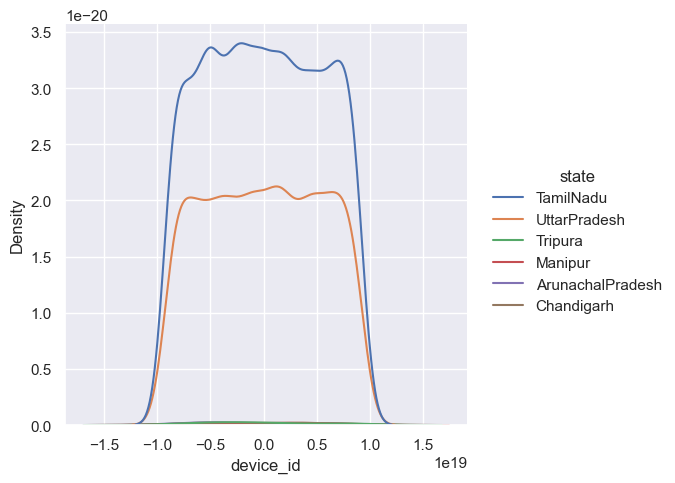

In [73]:
sns.displot(data = df_ed_6states_UID, x = 'device_id', hue = 'state', kind = 'kde')

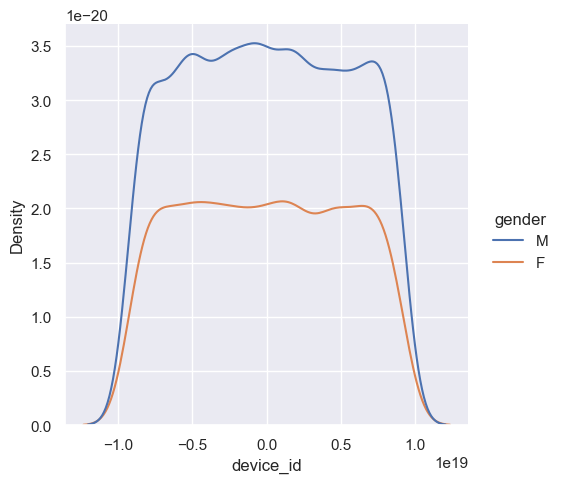

In [74]:
sns.displot(data = df_ed_6states_UID, x = 'device_id', hue = 'gender', kind = 'kde')

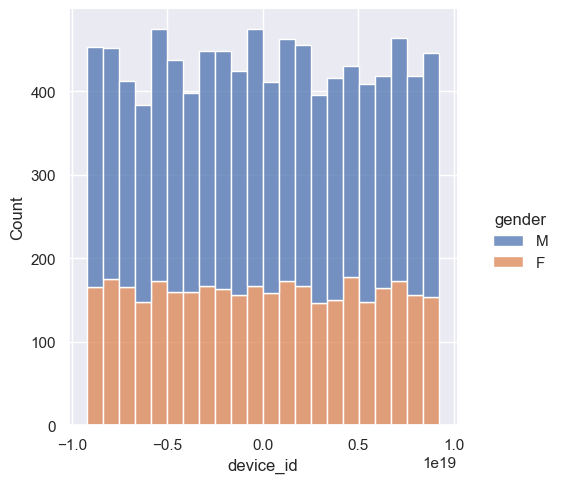

In [75]:
sns.displot(data = df_ed_6states_UID, x = 'device_id', hue = 'gender', multiple = 'stack')

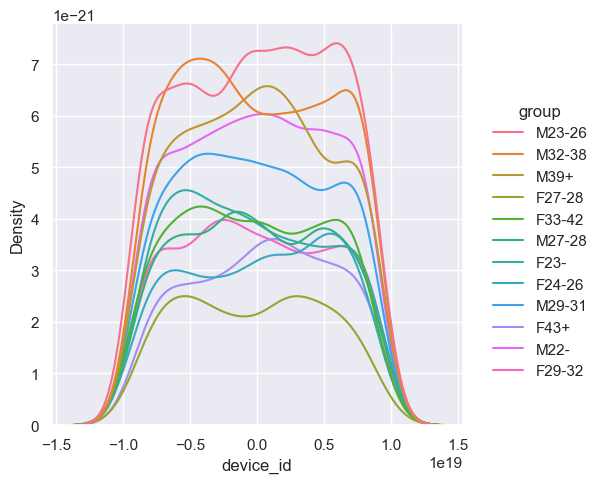

In [76]:
sns.displot(data = df_ed_6states_UID, x = 'device_id', hue = 'group', kind = 'kde')

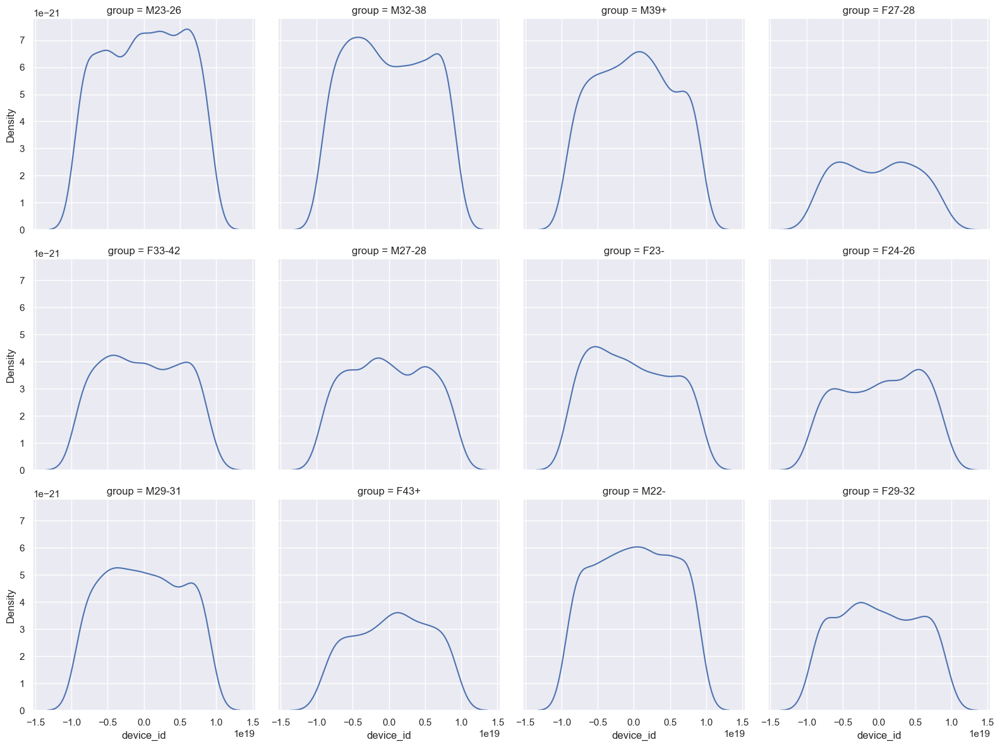

In [77]:
sns.displot(data = df_ed_6states_UID, x = 'device_id', col = 'group', kind = 'kde', height = 4, aspect = 1, col_wrap = 4)

In [78]:
map_UP = folium.Map(location=[26.8467, 80.9462], zoom_start=6)
mc = MarkerCluster()
state_list = ['UttarPradesh']

for state in state_list:
    mapping_data = df_ed_6states_UID[['latitude', 'longitude','city']][df_ed_6states_UID['state']==state].drop_duplicates()
    citylist = mapping_data['city'].tolist()
        
    locations = mapping_data[['latitude', 'longitude']]
    locationlist = locations.values.tolist()
    
    for index, item in enumerate(locationlist):
        mc.add_child(folium.Marker(location=item, popup=citylist[index]))
                             
map_UP.add_child(mc)
map_UP.save("UP_map_plot.html")
map_UP

In [79]:
map_TN = folium.Map(location=[13.143763, 80.327087], zoom_start=6)
mc = MarkerCluster()
state_list = ['TamilNadu']

for state in state_list:
    mapping_data = df_ed_6states_UID[['latitude', 'longitude','city']][df_ed_6states_UID['state']==state].drop_duplicates()
    citylist = mapping_data['city'].tolist()
        
    locations = mapping_data[['latitude', 'longitude']]
    locationlist = locations.values.tolist()
    
    for index, item in enumerate(locationlist):
        mc.add_child(folium.Marker(location=item, popup=citylist[index]))
                             
map_TN.add_child(mc)
map_TN.save("TN_map_plot.html")
map_TN

In [80]:
map_CN = folium.Map(location=[30.7333, 76.7794], zoom_start=10)
mc = MarkerCluster()
state_list = ['Chandigarh']

for state in state_list:
    mapping_data = df_ed_6states_UID[['latitude', 'longitude','city']][df_ed_6states_UID['state']==state].drop_duplicates()
    citylist = mapping_data['city'].tolist()
        
    locations = mapping_data[['latitude', 'longitude']]
    locationlist = locations.values.tolist()
    
    for index, item in enumerate(locationlist):
        mc.add_child(folium.Marker(location=item, popup=citylist[index]))
                             
map_CN.add_child(mc)
map_CN.save("CN_map_plot.html")
map_CN

In [81]:
map_AP = folium.Map(location=[27.5861, 91.8594], zoom_start=9)
mc = MarkerCluster()
state_list = ['ArunachalPradesh']

for state in state_list:
    mapping_data = df_ed_6states_UID[['latitude', 'longitude','city']][df_ed_6states_UID['state']==state].drop_duplicates()
    citylist = mapping_data['city'].tolist()
        
    locations = mapping_data[['latitude', 'longitude']]
    locationlist = locations.values.tolist()
    
    for index, item in enumerate(locationlist):
        mc.add_child(folium.Marker(location=item, popup=citylist[index]))
                             
map_AP.add_child(mc)
map_AP.save("AP_map_plot.html")
map_AP

In [82]:
map_MN = folium.Map(location=[24.6637, 93.9063], zoom_start=9)
mc = MarkerCluster()
state_list = ['Manipur']

for state in state_list:
    mapping_data = df_ed_6states_UID[['latitude', 'longitude','city']][df_ed_6states_UID['state']==state].drop_duplicates()
    citylist = mapping_data['city'].tolist()
        
    locations = mapping_data[['latitude', 'longitude']]
    locationlist = locations.values.tolist()
    
    for index, item in enumerate(locationlist):
        mc.add_child(folium.Marker(location=item, popup=citylist[index]))
                             
map_MN.add_child(mc)
map_MN.save("MN_map_plot.html")
map_MN

In [83]:
map_TP = folium.Map(location=[23.9408, 91.9882], zoom_start=9)
mc = MarkerCluster()
state_list = ['Tripura']

for state in state_list:
    mapping_data = df_ed_6states_UID[['latitude', 'longitude','city']][df_ed_6states_UID['state']==state].drop_duplicates()
    citylist = mapping_data['city'].tolist()
        
    locations = mapping_data[['latitude', 'longitude']]
    locationlist = locations.values.tolist()
    
    for index, item in enumerate(locationlist):
        mc.add_child(folium.Marker(location=item, popup=citylist[index]))
                             
map_TP.add_child(mc)
map_TP.save("TP_map_plot.html")
map_TP